### Загрузка индексов для векторизации времени

Задача: предложить и реализовать один или несколько подходов к построению вектора (embedding) времени, используя в качестве базовых признаков рыночные индексы


### Plan:
- Build EDA to explore the data
- Introduce methods to build embeddings for time series
- Explore Time2Vec approach
- Alternatives to the time2vec
- Provide a model
  - v1 trained on original data
  - v2 trained on enriched with embeddings data
- Compare metrics

In [1]:
# !pip install yfinance

In [2]:
# Load libraries
import pandas as pd
import seaborn as sns
#import pandas_datareader as dr
import yfinance as yf
from datetime import datetime
from pandas_datareader import data as pdr

import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.express as px

import numpy as np
import torch
import torch.nn as nn
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from datetime import datetime
import random
from sklearn.preprocessing import StandardScaler

import warnings
warnings.filterwarnings('ignore')

random_seed = 42
random.seed(random_seed)
np.random.seed(random_seed)
torch.manual_seed(random_seed)

# For CUDA with PyTorch
torch.cuda.manual_seed(random_seed)
torch.cuda.manual_seed_all(random_seed)
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False


In [3]:
# Check if CUDA is available
cuda_available = torch.cuda.is_available()
print(f"CUDA available: {cuda_available}")

# Set device to CUDA if available
device = torch.device("cuda" if cuda_available else "cpu")

CUDA available: True


In [4]:
yindex = {
  '^GSPC':'SP500',
  '^VIX': 'Индекс страха',
  'IMOEX.ME': 'Индекс мосбиржи',
  'RUBUSD=X': 'Курс доллара к рублю',
  'BZ=F': 'Цены на нефть марки Brent',
  'NG=F':  'Цена на газ',
  '^XAU': 'Индекс золото и серебро',
  '^DJI': 'Индекс деловой активности DOW',
  '^IXIC': 'Индекс технологических компаний',
  '^NYA':'NYSE Composite',
  '^XAX':'NYSE AMEX COMPOSITE INDEX',
  '^BUK100P':'Cboe UK 100',
  '^RUT':'Russell 2000',
  '^FTSE':'FTSE 100',
  '^GDAXI':'DAX PERFORMANCE-INDEX',
  '^FCHI':'CAC 40',
  '^STOXX50E':'ESTX 50 PR.EUR',
  '^N100':'Euronext 100 Index',
  '^BFX':'BEL 20',
  '^N225':'Nikkei 225',
  '^HSI':'HANG SENG INDEX',
  '000001.SS':'SSE Composite Index',
  '399001.SZ':'Shenzhen Index',
  '^STI':'STI Index',
  '^AORD':'ALL ORDINARIES',
  '^KS11':'KOSPI Composite Index',
  'GC=F':'Gold price',
  'CL=F':'Crude Oil price',
  'SI=F':'Silver price',
  'EURUSD=X':'EUR/USD',
  '^TNX':'Treasury Yield 10 Years',
  'GBPUSD=X':'GBP/USD',
  'JPY=X':'USD/JPY',
  'BTC-USD':'Bitcoin USD',
  '^CMC200':'CMC Crypto 200 Index by Solacti',
}

yindex_r = {yindex[key]: key for key, value in yindex.items()} 


In [5]:
yindex_r.keys()

dict_keys(['SP500', 'Индекс страха', 'Индекс мосбиржи', 'Курс доллара к рублю', 'Цены на нефть марки Brent', 'Цена на газ', 'Индекс золото и серебро', 'Индекс деловой активности DOW', 'Индекс технологических компаний', 'NYSE Composite', 'NYSE AMEX COMPOSITE INDEX', 'Cboe UK 100', 'Russell 2000', 'FTSE 100', 'DAX PERFORMANCE-INDEX', 'CAC 40', 'ESTX 50 PR.EUR', 'Euronext 100 Index', 'BEL 20', 'Nikkei 225', 'HANG SENG INDEX', 'SSE Composite Index', 'Shenzhen Index', 'STI Index', 'ALL ORDINARIES', 'KOSPI Composite Index', 'Gold price', 'Crude Oil price', 'Silver price', 'EUR/USD', 'Treasury Yield 10 Years', 'GBP/USD', 'USD/JPY', 'Bitcoin USD', 'CMC Crypto 200 Index by Solacti'])

## EDA

In [6]:
df = pd.read_csv("./index_data.csv", index_col=0)

In [7]:
df.head()

,SP500,Индекс страха,Индекс мосбиржи,Курс доллара к рублю,Цены на нефть марки Brent,Цена на газ,Индекс золото и серебро,Индекс деловой активности DOW,Индекс технологических компаний,NYSE Composite,...,KOSPI Composite Index,Gold price,Crude Oil price,Silver price,EUR/USD,Treasury Yield 10 Years,GBP/USD,USD/JPY,Bitcoin USD,CMC Crypto 200 Index by Solacti
Date,,,,,,,,,,,,,,,,,,,,,
2009-01-02,931.799988,39.189999,NaN,0.034847,46.910000,5.971,123.430000,9034.690430,1632.209961,5915.729980,...,1157.400024,878.799988,46.340000,11.465,1.392292,2.416,1.452391,91.790001,NaN,NaN
2009-01-05,927.450012,39.080002,NaN,0.034551,49.619999,6.072,118.779999,8952.889648,1628.030029,5908.430176,...,1173.569946,857.200012,48.810001,11.245,1.364592,2.488,1.471605,93.217003,NaN,NaN
2009-01-06,934.700012,38.560001,NaN,0.034613,50.529999,5.983,121.449997,9015.099609,1652.380005,5968.839844,...,1194.280029,865.400024,48.580002,11.420,1.351004,2.505,1.491202,93.379997,NaN,NaN
2009-01-07,906.650024,43.389999,NaN,0.034277,45.860001,5.872,111.290001,8769.700195,1599.060059,5799.049805,...,1228.170044,841.099976,42.630001,11.080,1.361100,2.494,1.507909,92.680000,NaN,NaN
2009-01-08,909.729980,42.560001,NaN,0.035263,44.669998,5.583,117.410004,8742.459961,1617.010010,5837.140137,...,1205.699951,853.900024,41.700001,11.072,1.369901,2.445,1.522696,91.360001,NaN,NaN


In [8]:
def plot_indices_comparison(data: pd.DataFrame, batch_indices: list, name: str, normalized=False):
    # Create subplots: one for original data, one for normalized data
    fig = make_subplots()

    for column in batch_indices:
        if column in data.columns:
            if normalized:
                # Normalize the series to 0-100% range
                series = data[column]
                min_val = series.min()
                max_val = series.max()
                normalized_series = 100 * (series - min_val) / (max_val - min_val)
                fig.add_trace(go.Scatter(x=data.index,
                                         y=normalized_series,
                                         mode='lines',
                                         name=column,
                                         line={'width': 1.5})
                                        )
            # Original Data
            else:
                fig.add_trace(go.Scatter(x=data.index, 
                                         y=data[column], 
                                         mode='lines', 
                                         name=column,
                                        line={'width': 1.5})
                             )

    # Update layout
    fig.update_layout(title=name + ' Normalized' if normalized else name,
                      xaxis_title='Date',
                      legend_title='Indices normalized' if normalized else "Indices",)

    # Show the plot
    fig.show()


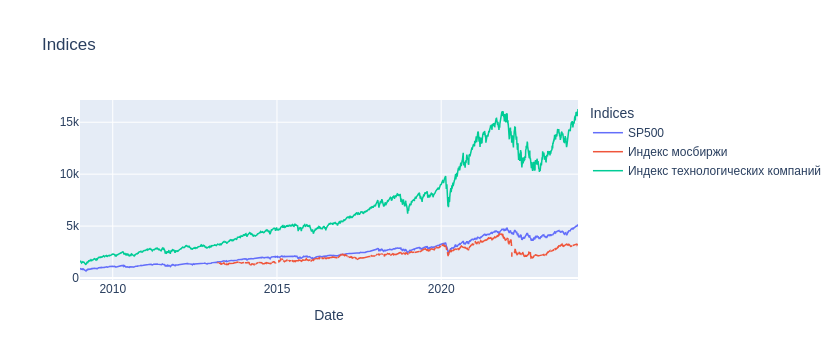

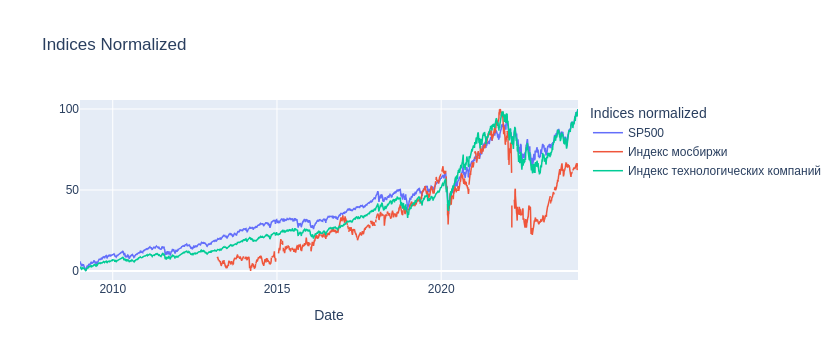

In [9]:
batch_index = [
  'SP500',
  'Индекс мосбиржи',
  'Индекс технологических компаний',
]

plot_indices_comparison(df,
                        batch_index, 
                        'Indices')

plot_indices_comparison(df,
                        batch_index, 
                        'Indices',
                        normalized=True)


In [10]:
indices_dict = {
    "Stock Indices vs. Fear Index": ['SP500', 'Индекс мосбиржи', 'Индекс страха'],
    "Currency Exchange Rates vs. Stock Indices": ['SP500', 'Индекс мосбиржи', 'EUR/USD', 'GBP/USD', 'USD/JPY'],
    "Commodity Prices (Gold, Silver, Oil) vs. Economic Indices": ['Gold price', 'Silver price', 'Crude Oil price', 'Индекс деловой активности DOW', 'Индекс технологических компаний'],
    "Cryptocurrency (Bitcoin) vs. Traditional Markets": ['Bitcoin USD', 'SP500', 'Индекс мосбиржи', 'Индекс золото и серебро'],
    "Energy Sector Indicators": ['Crude Oil price', 'Цена на газ', 'Индекс деловой активности DOW', 'Индекс технологических компаний'],
    "Global Stock Indices": ['SP500', 'Индекс мосбиржи', 'NYSE Composite', 'NYSE AMEX COMPOSITE INDEX', 'Cboe UK 100', 'Russell 2000', 'FTSE 100', 'DAX PERFORMANCE-INDEX', 'CAC 40', 'ESTX 50 PR.EUR', 'Euronext 100 Index', 'BEL 20', 'Nikkei 225', 'HANG SENG INDEX', 'SSE Composite Index', 'Shenzhen Index', 'STI Index', 'ALL ORDINARIES', 'KOSPI Composite Index'],
    "Interest Rates and Currencies": ['EUR/USD', 'GBP/USD', 'USD/JPY', 'Treasury Yield 10 Years', 'Курс доллара к рублю'],
    "Asian Stock Markets": ['Nikkei 225', 'HANG SENG INDEX', 'SSE Composite Index', 'Shenzhen Index', 'STI Index', 'KOSPI Composite Index']
}

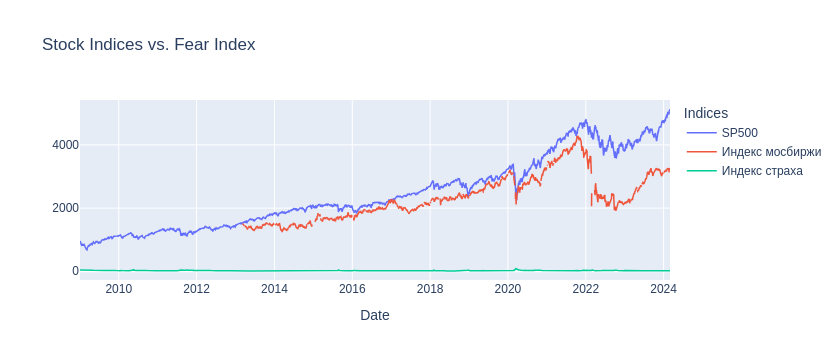

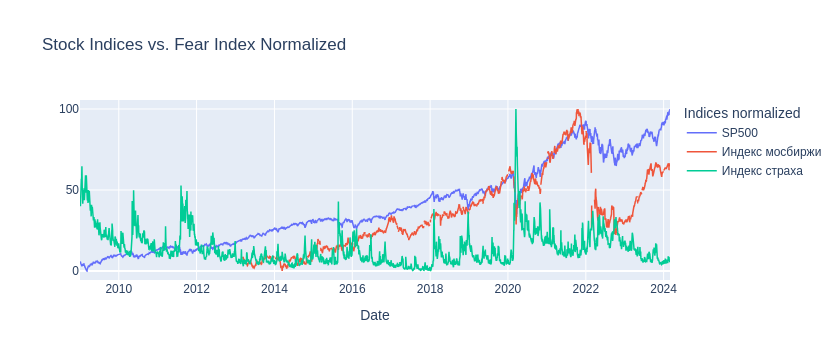

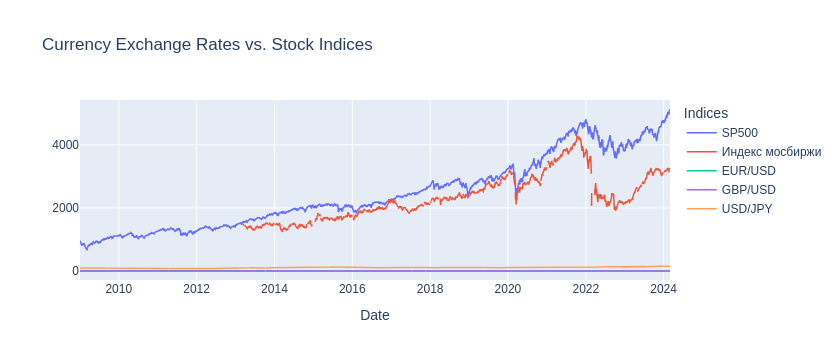

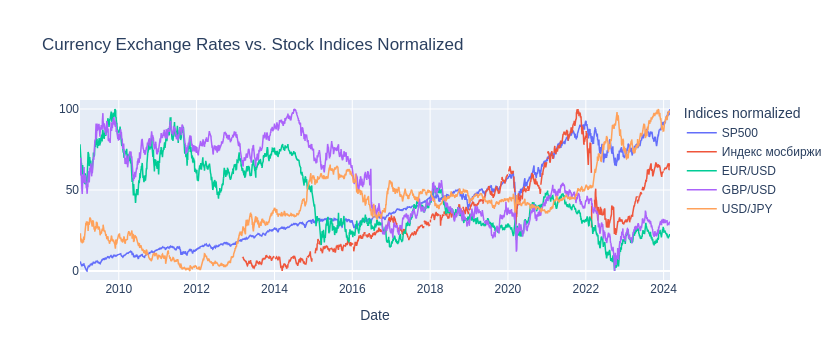

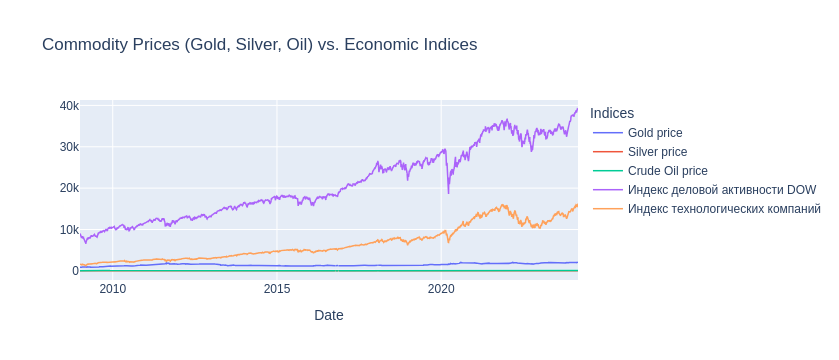

...

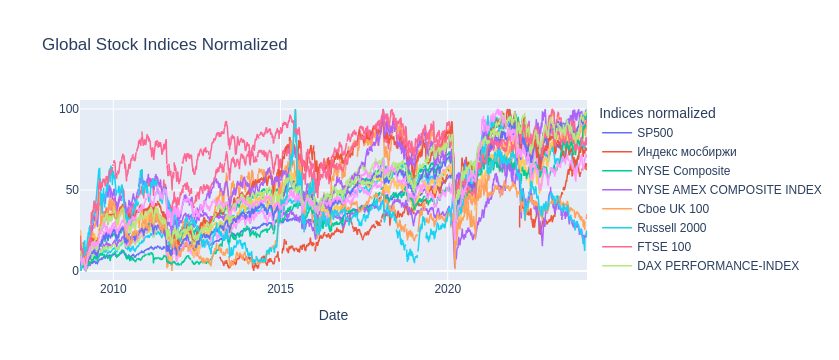

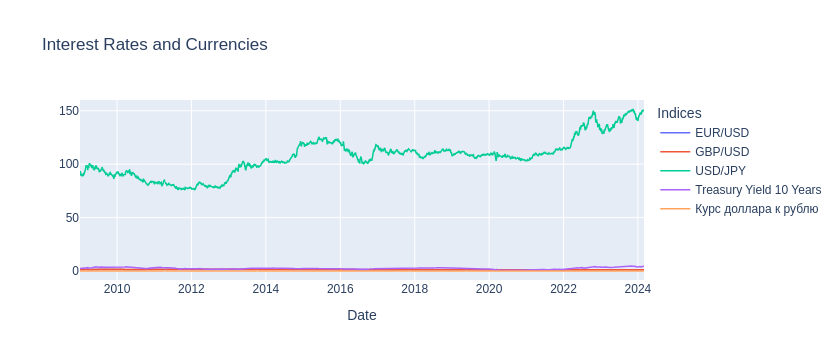

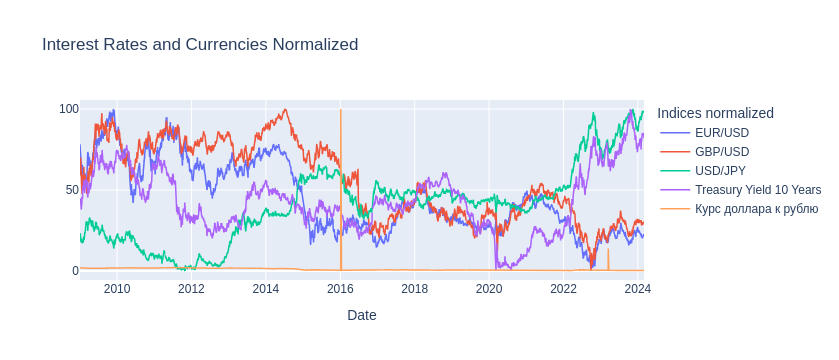

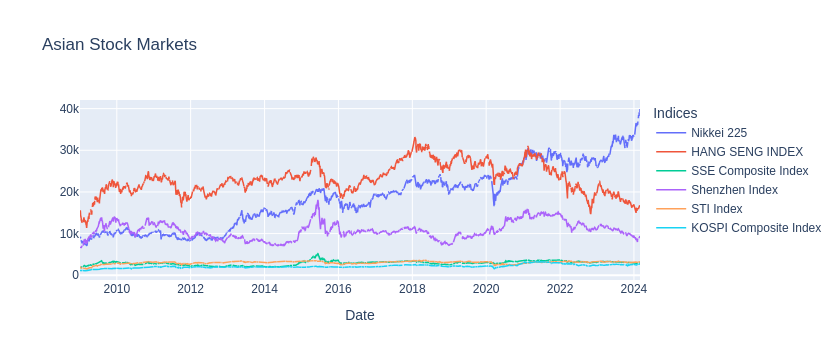

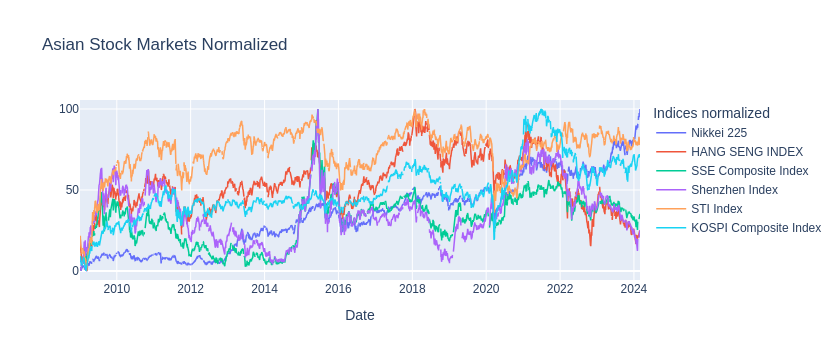

In [11]:
for title, batch_index in indices_dict.items():
    plot_indices_comparison(data=df,
                            batch_indices=batch_index,
                            name=title,
                            normalized=False,)
    
    plot_indices_comparison(data=df,
                            batch_indices=batch_index,
                            name=title,
                            normalized=True,)

As I can see, there are a lot of interesting patterns in data. Mutual indices could probably be used as meta-values to enrich dataset.

But first I would like to see if time2vec method could bring any insights on the data

## Embeddings

Generating embeddings from time series data, such as stock market indices, can be a powerful approach for capturing complex temporal dynamics and relationships. Embeddings, in this context, are low-dimensional, learned representations of the data that can be used for various ML tasks. 
Here's a general approach to generate embeddings from the time series data:

- Time2Vec: Time2Vec is a method for encoding time in a vector space, capturing periodic and non-periodic patterns. It can be a good choice if the temporal aspect is crucial.

- Autoencoders: Use an autoencoder neural network to learn a compressed representation of the time series data.

- Recurrent Neural Networks (RNNs)/LSTMs: RNNs and LSTMs can be used to learn embeddings by training them to predict the next step(s) in the time series.

- Transformers: Transformer models have been applied successfully to time series data. Transformer model can capture various connections in the data due to attention mechanism. But from my practice training a transformer model could be a complex process of finding right amounts of data and tuning hyperparameters.

## Understanding Time2Vec
Time2Vec can be implemented in two forms:

- Time2Vec (Linear): The first element of the Time2Vec vector is a linear function of time.
- Time2Vec (Periodic): The remaining elements are periodic functions of time (like sine and cosine).
The key idea is to transform a scalar timestamp into a vector that encodes different aspects of time, which can then be used as input features for the models.

#### Time2Vec in PyTorch
Here's a basic implementation of Time2Vec in PyTorch:

In [12]:
class Time2VecBasic(nn.Module):
    def __init__(self, period_dim):
        super(Time2VecBasic, self).__init__()
        self.period_dim = period_dim
        self.linear = nn.Linear(1, 1, bias=False)
        self.periodic = nn.Linear(1, period_dim, bias=False)
        self.normalize = nn.LayerNorm(1)  # Normalization layer

    def forward(self, x):
        x = x.unsqueeze(-1) if len(x.shape) == 1 else x
        linear_out = self.normalize(self.linear(x))  # Normalize linear output
        return torch.cat((linear_out, torch.sin(self.periodic(x))), dim=-1)


In [13]:
# Example usage
time2vec_b = Time2VecBasic(period_dim=3)
timestamps_b = torch.tensor([1, 2, 3, 4], dtype=torch.float32) 
time_embeddings_b = time2vec_b(timestamps_b)
print(time_embeddings_b)

tensor([[-2.3861e-06,  7.3794e-01, -2.3214e-01,  7.9476e-01],
        [-4.7722e-06,  9.9602e-01, -4.5159e-01,  9.6472e-01],
        [-2.2417e-05,  6.0643e-01, -6.4637e-01,  3.7626e-01],
        [-9.5444e-06, -1.7749e-01, -8.0584e-01, -5.0799e-01]],
       grad_fn=<CatBackward0>)


More complex approach

- Multiple Input Dimensions: The model now supports multiple input dimensions (input_dim). This allows you to use multiple indices as input to the model.

- Bias in Linear Part: A bias term is included in the linear transformation for more flexibility.

- Periodic Weights: The periodic weights are applied after the sine function, allowing for a varied impact of the periodic component across different embedding dimensions.



In [14]:
class Time2Vec(nn.Module):
    def __init__(self, input_dim, embed_dim):
        super(Time2Vec, self).__init__()
        self.input_dim = input_dim
        self.embed_dim = embed_dim

        # Linear part
        self.linear = nn.Linear(input_dim, embed_dim, bias=True)
        self.linear_norm = nn.LayerNorm(embed_dim)  # Normalization layer for linear part
        
        # Periodic part
        self.periodic = nn.Linear(input_dim, embed_dim, bias=False)
        self.periodic_norm = nn.LayerNorm(embed_dim)  # Normalization layer for periodic part
        self.periodic_weights = nn.Parameter(torch.randn(embed_dim))

    def forward(self, x):
        # Linear part with normalization
        linear_out = self.linear_norm(self.linear(x))

        # Periodic part with normalization and sine function
        periodic_out = torch.sin(self.periodic_norm(self.periodic(x)) * self.periodic_weights)

        # Combine linear and periodic parts
        return linear_out + periodic_out


Time2Vec takes a number of periodic dimensions as an argument. It then applies a linear transformation to the input time and a periodic transformation using the sine function. 

We can experiment with other periodic functions and parameters.

##### Time2Vec can be beneficial in tasks like:

- Time series forecasting
- Sequence modeling for events over time
- Enhancing features for models where time is a crucial factor

### Integrating Time2Vec with Indices Data

- Time Feature Extraction: The first step is to convert the timestamp of each data point (typically the date) into a Time2Vec representation. This involves transforming each timestamp into a vector that encapsulates both linear and periodic aspects of time.

- Concatenate with Original Features: then concatenate these Time2Vec embeddings with the original features of the dataset (e.g., the closing prices of different indices).

- Model Building: The combined dataset (original features + Time2Vec embeddings) can then be fed into a model. This model could be a simple linear regression or a complex neural network.

In [15]:
data = df.copy(deep=True)
data['Date'] = pd.to_datetime(data.index)  # Convert 'Date' column to datetime
data.fillna(0, inplace=True)

In [16]:
data.index[0]

'2009-01-02'

In [17]:
data

,SP500,Индекс страха,Индекс мосбиржи,Курс доллара к рублю,Цены на нефть марки Brent,Цена на газ,Индекс золото и серебро,Индекс деловой активности DOW,Индекс технологических компаний,NYSE Composite,...,Gold price,Crude Oil price,Silver price,EUR/USD,Treasury Yield 10 Years,GBP/USD,USD/JPY,Bitcoin USD,CMC Crypto 200 Index by Solacti,Date
Date,,,,,,,,,,,,,,,,,,,,,
2009-01-02,931.799988,39.189999,0.000000,0.034847,46.910000,5.971,123.430000,9034.690430,1632.209961,5915.729980,...,878.799988,46.340000,11.465000,1.392292,2.416,1.452391,91.790001,0.000000,0.000000,2009-01-02
2009-01-05,927.450012,39.080002,0.000000,0.034551,49.619999,6.072,118.779999,8952.889648,1628.030029,5908.430176,...,857.200012,48.810001,11.245000,1.364592,2.488,1.471605,93.217003,0.000000,0.000000,2009-01-05
2009-01-06,934.700012,38.560001,0.000000,0.034613,50.529999,5.983,121.449997,9015.099609,1652.380005,5968.839844,...,865.400024,48.580002,11.420000,1.351004,2.505,1.491202,93.379997,0.000000,0.000000,2009-01-06
2009-01-07,906.650024,43.389999,0.000000,0.034277,45.860001,5.872,111.290001,8769.700195,1599.060059,5799.049805,...,841.099976,42.630001,11.080000,1.361100,2.494,1.507909,92.680000,0.000000,0.000000,2009-01-07
2009-01-08,909.729980,42.560001,0.000000,0.035263,44.669998,5.583,117.410004,8742.459961,1617.010010,5837.140137,...,853.900024,41.700001,11.072000,1.369901,2.445,1.522696,91.360001,0.000000,0.000000,2009-01-08
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-02-26,5069.529785,13.740000,3213.169922,0.010748,82.529999,1.659,105.190002,39069.230469,15976.250000,17566.609375,...,2028.500000,77.580002,22.517000,1.082005,4.299,1.267267,150.498001,54522.402344,1140.447021,2024-02-26
2024-02-27,5078.180176,13.430000,3208.989990,0.010885,83.650002,1.615,104.389999,38972.410156,16035.299805,17598.320312,...,2034.000000,78.870003,22.523001,1.085093,4.315,1.268456,150.565994,57085.371094,1185.248047,2024-02-27
2024-02-28,5069.759766,13.840000,3227.050049,0.010885,83.680000,1.885,102.940002,38949.019531,15947.740234,17573.689453,...,2033.000000,78.540001,22.410000,1.084481,4.274,1.268166,150.494995,62504.789062,1277.404053,2024-02-28


#### Get timestamps

In [18]:
# Example: Convert dates to numerical format (number of days since start)
start_date = datetime(2009, 1, 2)  
data['timestamp'] = (data["Date"]
                     .astype('str')
                     .apply(lambda x: (datetime.strptime(x, '%Y-%m-%d') - start_date).days))

In [19]:
timestamps = torch.tensor(data['timestamp'].values,
                          dtype=torch.float32).view(-1, 1)
timestamps.shape

torch.Size([3816, 1])

In [20]:
timestamps = torch.tensor(data['timestamp'].values,
                          dtype=torch.float32).view(-1, 1)

# Initialize Time2Vec with the appropriate dimensions
# Let's say we want an embedding dimension of 5
input_dim = timestamps.shape[1]  # Number of input features (time-related)
embed_dim = 5

time2vec = Time2Vec(input_dim, embed_dim)

# Transform the timestamps using Time2Vec
time_embeddings = time2vec(timestamps)


In [21]:
time_embeddings.shape

torch.Size([3816, 5])

In [22]:
# Convert time embeddings to a DataFrame
time_embeddings_df = pd.DataFrame(time_embeddings.detach().numpy(),
                                  columns=[f'time_emb_{i}' 
                                           for i in range(time_embeddings.shape[1])])
time_embeddings_df.index = data.index

In [23]:
# Concatenate with original data
ts_enhanced_data = pd.concat([data, time_embeddings_df], axis=1)

In [24]:
ts_enhanced_data

,SP500,Индекс страха,Индекс мосбиржи,Курс доллара к рублю,Цены на нефть марки Brent,Цена на газ,Индекс золото и серебро,Индекс деловой активности DOW,Индекс технологических компаний,NYSE Composite,...,USD/JPY,Bitcoin USD,CMC Crypto 200 Index by Solacti,Date,timestamp,time_emb_0,time_emb_1,time_emb_2,time_emb_3,time_emb_4
Date,,,,,,,,,,,,,,,,,,,,,
2009-01-02,931.799988,39.189999,0.000000,0.034847,46.910000,5.971,123.430000,9034.690430,1632.209961,5915.729980,...,91.790001,0.000000,0.000000,2009-01-02,0,-1.716632,1.111116,-0.092153,0.881083,-0.183414
2009-01-05,927.450012,39.080002,0.000000,0.034551,49.619999,6.072,118.779999,8952.889648,1628.030029,5908.430176,...,93.217003,0.000000,0.000000,2009-01-05,3,-0.436821,0.259669,-1.603276,0.941712,1.450958
2009-01-06,934.700012,38.560001,0.000000,0.034613,50.529999,5.983,121.449997,9015.099609,1652.380005,5968.839844,...,93.379997,0.000000,0.000000,2009-01-06,4,-0.357940,0.186745,-1.654819,0.916735,1.521522
2009-01-07,906.650024,43.389999,0.000000,0.034277,45.860001,5.872,111.290001,8769.700195,1599.060059,5799.049805,...,92.680000,0.000000,0.000000,2009-01-07,5,-0.304303,0.138782,-1.685725,0.898599,1.564889
2009-01-08,909.729980,42.560001,0.000000,0.035263,44.669998,5.583,117.410004,8742.459961,1617.010010,5837.140137,...,91.360001,0.000000,0.000000,2009-01-08,6,-0.265711,0.104999,-1.706111,0.885036,1.594031
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-02-26,5069.529785,13.740000,3213.169922,0.010748,82.529999,1.659,105.190002,39069.230469,15976.250000,17566.609375,...,150.498001,54522.402344,1140.447021,2024-02-26,5533,-0.036286,-0.085276,-1.800357,0.796912,1.737252
2024-02-27,5078.180176,13.430000,3208.989990,0.010885,83.650002,1.615,104.389999,38972.410156,16035.299805,17598.320312,...,150.565994,57085.371094,1185.248047,2024-02-27,5534,-0.036286,-0.085276,-1.800357,0.796912,1.737252
2024-02-28,5069.759766,13.840000,3227.050049,0.010885,83.680000,1.885,102.940002,38949.019531,15947.740234,17573.689453,...,150.494995,62504.789062,1277.404053,2024-02-28,5535,-0.036286,-0.085277,-1.800357,0.796912,1.737252


### How to Apply Time2Vec to Indices Data:
- 1 Data Preparation: the indices data (like SP500, VIX, etc.) is time-series data where each data point corresponds to a specific date. The first step is to convert these dates into a numerical format (e.g., timestamps or the number of days since a starting date) if not already done.

- 2 Generate Time Embeddings: Apply the Time2Vec model to these numerical time values to generate embeddings. Each time point is transformed into a vector capturing both linear and periodic aspects of time.

- 3 Combine with Indices Data: The generated Time2Vec embeddings can then be concatenated with the original indices data. This enriched dataset now contains both the original index values and their respective time embeddings.

- 4 Modeling and Analysis: Use this combined dataset for further analysis, such as predictive modeling, anomaly detection, or trend analysis. The Time2Vec embeddings provide additional temporal context that can enhance the performance of these tasks.

#### Notes
- Data Preprocessing: Ensure that the timestamps are processed correctly for the model.
- Experimentation: The effectiveness of Time2Vec may vary depending on the nature of the data and the specific task at hand. It's important to experiment with different configurations and validate the results.
- Application Scope: Time2Vec is particularly useful in scenarios where understanding temporal dynamics is crucial. For stock indices, this might mean capturing patterns related to market cycles, seasonal effects, or event-driven fluctuations.


#### Adding Other Embeddings
Regarding adding other types of embeddings to the DataFrame, there are a few possibilities to consider:

- Feature Embeddings from Indices Data: If you have high-dimensional data or complex relationships within the indices, you might consider embedding these features. Techniques like PCA or autoencoders can reduce dimensionality and capture interactions between different indices.

- External Data Embeddings: If you have additional data sources that might influence the indices (like economic indicators, news sentiment, etc.), you could create embeddings from this data and add them to the DataFrame.

- Categorical Embeddings: If the dataset includes categorical variables (like day of the week, month, or categorical market indicators), you could use embeddings to represent these categories. This is similar to how words are embedded in NLP tasks.

## Enrich the DataFrame with time2vec embeddings of stock prices

In [25]:
SP500_COL = 'SP500'

#### Split train and valid to train Scaler

In [26]:
features = list(yindex_r.keys())
features.extend(["timestamp"])

Make a copy of tstamp df to enrich it with indices embeddings

In [27]:
ids_enhanced_data = ts_enhanced_data.copy(deep=True)

In [28]:
ids_enhanced_data

,SP500,Индекс страха,Индекс мосбиржи,Курс доллара к рублю,Цены на нефть марки Brent,Цена на газ,Индекс золото и серебро,Индекс деловой активности DOW,Индекс технологических компаний,NYSE Composite,...,USD/JPY,Bitcoin USD,CMC Crypto 200 Index by Solacti,Date,timestamp,time_emb_0,time_emb_1,time_emb_2,time_emb_3,time_emb_4
Date,,,,,,,,,,,,,,,,,,,,,
2009-01-02,931.799988,39.189999,0.000000,0.034847,46.910000,5.971,123.430000,9034.690430,1632.209961,5915.729980,...,91.790001,0.000000,0.000000,2009-01-02,0,-1.716632,1.111116,-0.092153,0.881083,-0.183414
2009-01-05,927.450012,39.080002,0.000000,0.034551,49.619999,6.072,118.779999,8952.889648,1628.030029,5908.430176,...,93.217003,0.000000,0.000000,2009-01-05,3,-0.436821,0.259669,-1.603276,0.941712,1.450958
2009-01-06,934.700012,38.560001,0.000000,0.034613,50.529999,5.983,121.449997,9015.099609,1652.380005,5968.839844,...,93.379997,0.000000,0.000000,2009-01-06,4,-0.357940,0.186745,-1.654819,0.916735,1.521522
2009-01-07,906.650024,43.389999,0.000000,0.034277,45.860001,5.872,111.290001,8769.700195,1599.060059,5799.049805,...,92.680000,0.000000,0.000000,2009-01-07,5,-0.304303,0.138782,-1.685725,0.898599,1.564889
2009-01-08,909.729980,42.560001,0.000000,0.035263,44.669998,5.583,117.410004,8742.459961,1617.010010,5837.140137,...,91.360001,0.000000,0.000000,2009-01-08,6,-0.265711,0.104999,-1.706111,0.885036,1.594031
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-02-26,5069.529785,13.740000,3213.169922,0.010748,82.529999,1.659,105.190002,39069.230469,15976.250000,17566.609375,...,150.498001,54522.402344,1140.447021,2024-02-26,5533,-0.036286,-0.085276,-1.800357,0.796912,1.737252
2024-02-27,5078.180176,13.430000,3208.989990,0.010885,83.650002,1.615,104.389999,38972.410156,16035.299805,17598.320312,...,150.565994,57085.371094,1185.248047,2024-02-27,5534,-0.036286,-0.085276,-1.800357,0.796912,1.737252
2024-02-28,5069.759766,13.840000,3227.050049,0.010885,83.680000,1.885,102.940002,38949.019531,15947.740234,17573.689453,...,150.494995,62504.789062,1277.404053,2024-02-28,5535,-0.036286,-0.085277,-1.800357,0.796912,1.737252


In [29]:
for index in yindex_r:
    index_tn = torch.tensor(data[index].values, dtype=torch.float32).view(-1, 1)
    
    input_dim = index_tn.shape[1]
    embed_dim = 5
    
    time2vec = Time2Vec(input_dim, embed_dim)
    index_embeddings = time2vec(timestamps)
    
    # Convert time embeddings to a DataFrame
    index_embeddings_df = pd.DataFrame(index_embeddings.detach().numpy(),
                                      columns=[f'{index}_emb_{i}' 
                                               for i in range(index_embeddings.shape[1])])
    index_embeddings_df.index = data.index

    # Concatenate with original data
    ids_enhanced_data = pd.concat([ids_enhanced_data, index_embeddings_df], axis=1)

In [30]:
ids_enhanced_data.drop('Date', axis=1, inplace=True)

In [31]:
ids_enhanced_data

,SP500,Индекс страха,Индекс мосбиржи,Курс доллара к рублю,Цены на нефть марки Brent,Цена на газ,Индекс золото и серебро,Индекс деловой активности DOW,Индекс технологических компаний,NYSE Composite,...,Bitcoin USD_emb_0,Bitcoin USD_emb_1,Bitcoin USD_emb_2,Bitcoin USD_emb_3,Bitcoin USD_emb_4,CMC Crypto 200 Index by Solacti_emb_0,CMC Crypto 200 Index by Solacti_emb_1,CMC Crypto 200 Index by Solacti_emb_2,CMC Crypto 200 Index by Solacti_emb_3,CMC Crypto 200 Index by Solacti_emb_4
Date,,,,,,,,,,,,,,,,,,,,,
2009-01-02,931.799988,39.189999,0.000000,0.034847,46.910000,5.971,123.430000,9034.690430,1632.209961,5915.729980,...,1.135424,0.060267,-1.309618,1.053329,-0.939401,1.512239,-0.422709,-1.538801,0.405524,0.043747
2009-01-05,927.450012,39.080002,0.000000,0.034551,49.619999,6.072,118.779999,8952.889648,1628.030029,5908.430176,...,-0.971074,-0.641967,-0.765247,0.667687,0.940605,-0.356576,-1.468936,-0.638083,-0.454675,0.908378
2009-01-06,934.700012,38.560001,0.000000,0.034613,50.529999,5.983,121.449997,9015.099609,1652.380005,5968.839844,...,-1.002211,-0.679072,-0.554242,0.452422,1.013106,-0.566101,-1.516244,-0.440381,-0.483076,0.995908
2009-01-07,906.650024,43.389999,0.000000,0.034277,45.860001,5.872,111.290001,8769.700195,1599.060059,5799.049805,...,-1.003541,-0.701067,-0.444428,0.335926,1.043111,-0.708056,-1.530959,-0.303897,-0.506867,1.039885
2009-01-08,909.729980,42.560001,0.000000,0.035263,44.669998,5.583,117.410004,8742.459961,1617.010010,5837.140137,...,-0.999297,-0.715259,-0.378119,0.264069,1.058607,-0.808256,-1.533199,-0.206367,-0.525799,1.063725
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-02-26,5069.529785,13.740000,3213.169922,0.010748,82.529999,1.659,105.190002,39069.230469,15976.250000,17566.609375,...,-0.943962,-0.777733,-0.118889,-0.028478,1.099063,-1.331265,-1.433146,0.319073,-0.653940,1.089383
2024-02-27,5078.180176,13.430000,3208.989990,0.010885,83.650002,1.615,104.389999,38972.410156,16035.299805,17598.320312,...,-0.943962,-0.777733,-0.118889,-0.028477,1.099063,-1.331265,-1.433146,0.319073,-0.653940,1.089383
2024-02-28,5069.759766,13.840000,3227.050049,0.010885,83.680000,1.885,102.940002,38949.019531,15947.740234,17573.689453,...,-0.943962,-0.777733,-0.118889,-0.028478,1.099063,-1.331265,-1.433146,0.319073,-0.653940,1.089383


##### Possible PCA block to reduce dimensionality. Skipping this for now

In [32]:
# from sklearn.decomposition import PCA

In [33]:
# pca = PCA(n_components=12)  
# indices_embeddings = pca.fit_transform(ids_enhanced_data)

##### Continue without using PCA

Lets focus on predicting SP500 close price for the next week so days_shited=7

In [34]:
TARGET_COL = 'target'
TARGET_SHIFT = 7

In [35]:
data[TARGET_COL] = data[SP500_COL].shift(TARGET_SHIFT)
data[TARGET_COL].fillna(method='backfill', inplace=True)

In [36]:
# VALID_SIZE = data.shape[0] // 10
VALID_SIZE = 100

In [37]:
train_df, val_df = data.iloc[:-VALID_SIZE], data.iloc[-VALID_SIZE:]

In [38]:
SCALE_Y = False

In [39]:
# Extract the target values for training and validation sets
y_train = train_df[TARGET_COL].values
y_val = val_df[TARGET_COL].values

if SCALE_Y:
    # y scaler
    y_scaler = StandardScaler()
    
    y_train = y_scaler.fit_transform(y_train.reshape(-1, 1))
    y_val = y_scaler.transform(y_val.reshape(-1, 1))


#### Original data `data`

In [40]:
# Initialize the scaler
scaler = StandardScaler()

# Fit the scaler only on the training data
scaler.fit(train_df[features])

StandardScaler()

In [41]:
X_train = scaler.transform(train_df[features])

X_val = scaler.transform(val_df[features])

In [42]:
X_train.shape

(3716, 36)

## Models

In [43]:
from sklearn.metrics import (mean_absolute_error,
mean_squared_error,
r2_score,
mean_absolute_percentage_error,
)

def evaluate_model(model, X_test, y_test, y_pred, model_name, results_df=None):
    # Calculate metrics
    mae = mean_absolute_error(y_test, y_pred)
    mse = mean_squared_error(y_test, y_pred)
    # rmse = np.sqrt(mse)  # Calculate RMSE
    # mape = np.mean(np.abs((y_test - y_pred) / y_test)) * 100  # Calculate MAPE
    r2 = r2_score(y_test, y_pred)
    
    # Prepare the metrics dictionary
    metrics = {
        'Model': model_name,
        'MAE': mae,
        'MSE': mse,
        # 'RMSE': rmse,
        # 'MAPE': mape,
        'R2 Score': r2
    }
    
    print(metrics)
    # Add to the results DataFrame
    if results_df is None:
        results_df = pd.DataFrame(columns=metrics.keys())
    results_df = results_df.append(metrics, ignore_index=True)
    
    return results_df

#### Linear reg

In [44]:
from sklearn.linear_model import LinearRegression

# Initialize and fit the model
model_lr_base = LinearRegression()
model_lr_base.fit(X_train, y_train)

LinearRegression()

In [45]:
# Make predictions
y_pred = model_lr_base.predict(X_val)

# # Inverse transform the predictions if y was scaled
# y_pred = y_scaler.inverse_transform(y_pred)

In [46]:
results_df = pd.DataFrame()

In [47]:
results_df = evaluate_model(model=model_lr_base,
               X_test=X_val,
               y_test=y_val,
               y_pred=y_pred,
               model_name="model_lr_base",
               results_df=results_df)


{'Model': 'model_lr_base', 'MAE': 62.123962008342275, 'MSE': 6585.161678018486, 'R2 Score': 0.9009909504542429}


In [48]:
results_df

,Model,MAE,MSE,R2 Score
0,model_lr_base,62.123962,6585.161678,0.900991


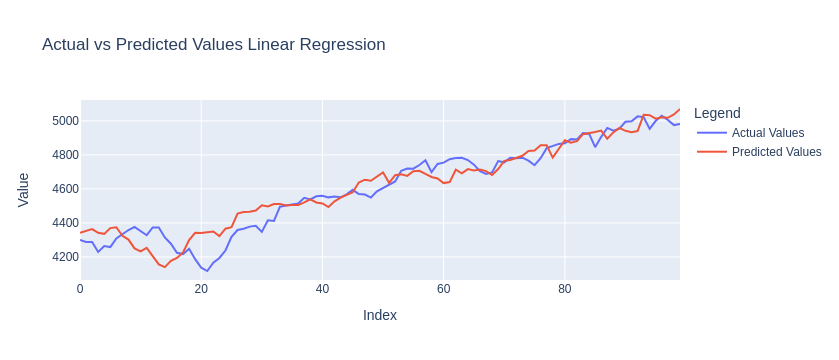

In [49]:
fig = go.Figure()

# Add actual values
fig.add_trace(go.Scatter(y=y_val, mode='lines', name='Actual Values'))

# Add predicted values
fig.add_trace(go.Scatter(y=y_pred, mode='lines', name='Predicted Values'))

# Update layout for clarity
fig.update_layout(title='Actual vs Predicted Values Linear Regression',
                  xaxis_title='Index',
                  yaxis_title='Value',
                  legend_title='Legend')

fig.show()


Either there is a dataleak somewhere, or indices correlate way too much. 
It is possible because normalized values correlate and we are predicting value for the same day

LR would have worse results if we got a task to predict for `current + k` day where k = [1, 2, ...] 

#### Indices enriched data

In [50]:
train_df[features]

,SP500,Индекс страха,Индекс мосбиржи,Курс доллара к рублю,Цены на нефть марки Brent,Цена на газ,Индекс золото и серебро,Индекс деловой активности DOW,Индекс технологических компаний,NYSE Composite,...,Gold price,Crude Oil price,Silver price,EUR/USD,Treasury Yield 10 Years,GBP/USD,USD/JPY,Bitcoin USD,CMC Crypto 200 Index by Solacti,timestamp
Date,,,,,,,,,,,,,,,,,,,,,
2009-01-02,931.799988,39.189999,0.000000,0.034847,46.910000,5.971,123.430000,9034.690430,1632.209961,5915.729980,...,878.799988,46.340000,11.465000,1.392292,2.416,1.452391,91.790001,0.000000,0.000000,0
2009-01-05,927.450012,39.080002,0.000000,0.034551,49.619999,6.072,118.779999,8952.889648,1628.030029,5908.430176,...,857.200012,48.810001,11.245000,1.364592,2.488,1.471605,93.217003,0.000000,0.000000,3
2009-01-06,934.700012,38.560001,0.000000,0.034613,50.529999,5.983,121.449997,9015.099609,1652.380005,5968.839844,...,865.400024,48.580002,11.420000,1.351004,2.505,1.491202,93.379997,0.000000,0.000000,4
2009-01-07,906.650024,43.389999,0.000000,0.034277,45.860001,5.872,111.290001,8769.700195,1599.060059,5799.049805,...,841.099976,42.630001,11.080000,1.361100,2.494,1.507909,92.680000,0.000000,0.000000,5
2009-01-08,909.729980,42.560001,0.000000,0.035263,44.669998,5.583,117.410004,8742.459961,1617.010010,5837.140137,...,853.900024,41.700001,11.072000,1.369901,2.445,1.522696,91.360001,0.000000,0.000000,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-10-02,4288.390137,17.610001,3132.330078,0.010208,90.709999,2.840,103.529999,33433.351562,13307.769531,15230.009766,...,1830.000000,88.820000,21.218000,1.056524,4.683,1.219304,149.539993,27530.785156,589.086975,5386
2023-10-03,4229.450195,19.780001,3143.879883,0.010125,90.919998,2.949,104.220001,33002.378906,13059.469727,15043.419922,...,1824.599976,89.230003,21.177999,1.048075,4.802,1.209117,149.850998,27429.978516,583.513977,5387
2023-10-04,4263.750000,18.580000,3134.250000,0.009904,85.809998,2.962,103.309998,33129.550781,13236.009766,15070.910156,...,1818.500000,84.220001,20.955999,1.047230,4.735,1.207846,149.192001,27799.394531,589.351990,5388


In [51]:
ids_enhanced_data[features]

,SP500,Индекс страха,Индекс мосбиржи,Курс доллара к рублю,Цены на нефть марки Brent,Цена на газ,Индекс золото и серебро,Индекс деловой активности DOW,Индекс технологических компаний,NYSE Composite,...,Gold price,Crude Oil price,Silver price,EUR/USD,Treasury Yield 10 Years,GBP/USD,USD/JPY,Bitcoin USD,CMC Crypto 200 Index by Solacti,timestamp
Date,,,,,,,,,,,,,,,,,,,,,
2009-01-02,931.799988,39.189999,0.000000,0.034847,46.910000,5.971,123.430000,9034.690430,1632.209961,5915.729980,...,878.799988,46.340000,11.465000,1.392292,2.416,1.452391,91.790001,0.000000,0.000000,0
2009-01-05,927.450012,39.080002,0.000000,0.034551,49.619999,6.072,118.779999,8952.889648,1628.030029,5908.430176,...,857.200012,48.810001,11.245000,1.364592,2.488,1.471605,93.217003,0.000000,0.000000,3
2009-01-06,934.700012,38.560001,0.000000,0.034613,50.529999,5.983,121.449997,9015.099609,1652.380005,5968.839844,...,865.400024,48.580002,11.420000,1.351004,2.505,1.491202,93.379997,0.000000,0.000000,4
2009-01-07,906.650024,43.389999,0.000000,0.034277,45.860001,5.872,111.290001,8769.700195,1599.060059,5799.049805,...,841.099976,42.630001,11.080000,1.361100,2.494,1.507909,92.680000,0.000000,0.000000,5
2009-01-08,909.729980,42.560001,0.000000,0.035263,44.669998,5.583,117.410004,8742.459961,1617.010010,5837.140137,...,853.900024,41.700001,11.072000,1.369901,2.445,1.522696,91.360001,0.000000,0.000000,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-02-26,5069.529785,13.740000,3213.169922,0.010748,82.529999,1.659,105.190002,39069.230469,15976.250000,17566.609375,...,2028.500000,77.580002,22.517000,1.082005,4.299,1.267267,150.498001,54522.402344,1140.447021,5533
2024-02-27,5078.180176,13.430000,3208.989990,0.010885,83.650002,1.615,104.389999,38972.410156,16035.299805,17598.320312,...,2034.000000,78.870003,22.523001,1.085093,4.315,1.268456,150.565994,57085.371094,1185.248047,5534
2024-02-28,5069.759766,13.840000,3227.050049,0.010885,83.680000,1.885,102.940002,38949.019531,15947.740234,17573.689453,...,2033.000000,78.540001,22.410000,1.084481,4.274,1.268166,150.494995,62504.789062,1277.404053,5535


In [52]:
ids_enhanced_data[features] = scaler.transform(ids_enhanced_data[features])

In [53]:
ids_enhanced_data[TARGET_COL] = data[TARGET_COL]

In [54]:
train_ids_enhanced_df, val_ids_enhanced_df = ids_enhanced_data.iloc[:-VALID_SIZE], ids_enhanced_data.iloc[-VALID_SIZE:]

X_train_ids_enhanced = scaler.transform(train_ids_enhanced_df[features])
X_val_ids_enhanced = scaler.transform(val_ids_enhanced_df[features])

y_train_ids_enhanced = train_ids_enhanced_df[TARGET_COL].values
y_val_ids_enhanced = val_ids_enhanced_df[TARGET_COL].values

In [55]:
# Initialize and fit the model
model_lr_ids_enhanced = LinearRegression()
model_lr_ids_enhanced.fit(X_train_ids_enhanced,
                          y_train_ids_enhanced)

LinearRegression()

In [56]:
# Make predictions
y_pred_ids_enhanced = model_lr_ids_enhanced.predict(X_val_ids_enhanced)

# # Inverse transform the predictions if y was scaled
# y_pred = y_scaler.inverse_transform(y_pred)

In [57]:
results_df = evaluate_model(model=model_lr_ids_enhanced,
               X_test=X_val_ids_enhanced,
               y_test=y_val_ids_enhanced,
               y_pred=y_pred_ids_enhanced,
               model_name="model_lr_ids_enhanced",
               results_df=results_df)

{'Model': 'model_lr_ids_enhanced', 'MAE': 62.12396200840827, 'MSE': 6585.161678033202, 'R2 Score': 0.9009909504540217}


Its hard to get any more improvements given the data is way too correlated. And the R2 score is way too high

In [58]:
results_df

,Model,MAE,MSE,R2 Score
0,model_lr_base,62.123962,6585.161678,0.900991
1,model_lr_ids_enhanced,62.123962,6585.161678,0.900991


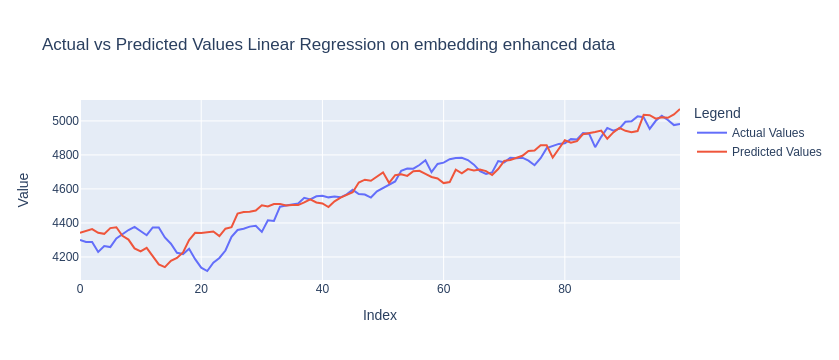

In [59]:
fig = go.Figure()

# Add actual values
fig.add_trace(go.Scatter(y=y_val_ids_enhanced, mode='lines', name='Actual Values'))

# Add predicted values
fig.add_trace(go.Scatter(y=y_pred_ids_enhanced, mode='lines', name='Predicted Values'))

fig.update_layout(title='Actual vs Predicted Values Linear Regression on embedding enhanced data',
                  xaxis_title='Index',
                  yaxis_title='Value',
                  legend_title='Legend')

fig.show()


Here above is the example of high dimensionality problem 

#### LSTM

In [60]:
class LSTMModel(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim, num_layers):
        """
        Initialize the LSTM Model.

        Parameters:
        input_dim (int): The number of input features (dimensions of the input data).
        hidden_dim (int): The number of features in the hidden state of the LSTM.
        output_dim (int): The number of output features (dimensions of the output data).
        num_layers (int): The number of stacked LSTM layers.
        """
        super(LSTMModel, self).__init__()
        
        # Define an LSTM layer
        # batch_first=True indicates that the first dimension of the input and output is the batch size
        self.lstm = nn.LSTM(input_dim, hidden_dim, num_layers, batch_first=True)
        
        # Define a fully connected layer to map the hidden state output to the desired output_dim
        self.fc = nn.Linear(hidden_dim, output_dim)
    
    def forward(self, x):
        """
        Define the forward pass of the model.

        Parameters:
        x (tensor): Input tensor to the LSTM model.

        Returns:
        out (tensor): Output tensor of the model.
        """
        # Forward pass through LSTM layer
        # The LSTM outputs hidden states for each time step, but we only use the last hidden state
        _, (hidden, _) = self.lstm(x)
        
        # The last hidden state is passed through a fully connected layer to get the final output
        # hidden[-1] gives the last layer's hidden state
        out = self.fc(hidden[-1])
        
        return out


In [61]:
# # For batch size > 1
# class LSTMModel(nn.Module):
#     def __init__(self, input_size, hidden_size, num_layers, output_size):
#         super(LSTMModel, self).__init__()
#         self.hidden_size = hidden_size
#         self.num_layers = num_layers
        
#         self.lstm = nn.LSTM(input_size, hidden_size, num_layers, batch_first=True)
#         self.fc = nn.Linear(hidden_size, output_size)
    
#     def forward(self, x):
#         # Initialize hidden state and cell state with zeros
#         h0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(x.device)
#         c0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(x.device)
        
#         # Forward propagate LSTM
#         out, _ = self.lstm(x, (h0, c0))
        
#         # Decode the hidden state of each time step
#         out = self.fc(out[:, -1, :])  # Apply the linear layer to each output
#         return out.squeeze()  # Remove extra dimensions

# # Adjust the input data shape if necessary (to be [batch_size, sequence_length, input_size])


In [62]:
# Convert data to PyTorch tensors
X_train_tn = torch.tensor(X_train, dtype=torch.float32)
X_val_tn = torch.tensor(X_val, dtype=torch.float32)

# unscaled y
y_train_tn = torch.tensor(y_train, dtype=torch.float32).view(-1, 1)
y_val_tn = torch.tensor(y_val, dtype=torch.float32).view(-1, 1)

In [63]:
X_train.shape

(3716, 36)

In [64]:
y_train_tn.shape

torch.Size([3716, 1])

In [65]:
input_dim = X_train_tn.shape[1]
hidden_dim = 64
output_dim = 1
num_layers = 2

model_lstm_base = LSTMModel(input_dim, hidden_dim, output_dim, num_layers)
criterion = nn.L1Loss() # or nn.MSELoss()
optimizer = torch.optim.Adam(model_lstm_base.parameters(), lr=3e-3)

model_lstm_base.to(device)

LSTMModel(
  (lstm): LSTM(36, 64, num_layers=2, batch_first=True)
  (fc): Linear(in_features=64, out_features=1, bias=True)
)

In [66]:
from torch.utils.data import TensorDataset

# Create TensorDatasets for training and validation
train_dataset = TensorDataset(X_train_tn, y_train_tn)
val_dataset = TensorDataset(X_val_tn, y_val_tn)


In [67]:
from torch.utils.data import DataLoader

# Define batch size
batch_size = 1 

# Create DataLoaders
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=False)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

In [68]:
device

device(type='cuda')

In [69]:
num_epochs = 20 

for epoch in range(num_epochs):
    model_lstm_base.train()  
    
    total_loss = 0
    for inputs, labels in train_loader:
        inputs, labels = inputs.to(device), labels.to(device)

        optimizer.zero_grad()
        outputs = model_lstm_base(inputs)

        # print(inputs.shape, labels.shape, outputs.shape)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        total_loss += loss.item()

    # Print average training loss per epoch
    avg_train_loss = total_loss / len(train_loader)
    if (epoch + 1) % 10 == 0:
        print(f'Epoch [{epoch+1}/{num_epochs}], Training Loss: {avg_train_loss:.4f}')

    # Validation step
    model_lstm_base.eval() 
    total_val_loss = 0
    with torch.no_grad():
        for inputs, labels in val_loader:
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = model_lstm_base(inputs)
            val_loss = criterion(outputs, labels)
            total_val_loss += val_loss.item()

    # Print average validation loss per epoch
    avg_val_loss = total_val_loss / len(val_loader)
    if (epoch + 1) % 10 == 0:
        print(f'Epoch [{epoch+1}/{num_epochs}], Validation Loss: {avg_val_loss:.4f}')
        print("---")


Epoch [10/20], Training Loss: 228.4730
Epoch [10/20], Validation Loss: 1313.9723
---
Epoch [20/20], Training Loss: 74.1509
Epoch [20/20], Validation Loss: 392.6751
---


Of course 20 epochs is not enough to train LSTM model, but we can see some progress in metrics

In case of simplicity we drop batch size optimization and early stopping

In [70]:
def evaluate_lstm_model_with_loader(model, val_loader, model_name, results_df=None, device='cpu'):
    model.eval() 
    model.to(device)

    all_preds = []
    all_labels = []

    # Generate predictions for the validation set
    with torch.no_grad():
        for inputs, labels in val_loader:
            inputs, labels = inputs.to(device), labels.to(device)

            # print("inputs, labels", inputs.shape, labels.shape)
            
            outputs = model(inputs)
            # print("outputs", outputs.shape)
            all_preds.extend(outputs.view(-1).cpu().numpy())
            all_labels.extend(labels.view(-1).cpu().numpy())
    
    
    # Calculate metrics
    mae = mean_absolute_error(all_labels, all_preds)
    mse = mean_squared_error(all_labels, all_preds)
    r2 = r2_score(all_labels, all_preds)

    # Prepare the metrics dictionary
    metrics = {
        'Model': model_name,
        'MAE': mae,
        'MSE': mse,
        'R2 Score': r2
    }
    
    print(metrics)

    # Add to the results DataFrame
    if results_df is None:
        results_df = pd.DataFrame(columns=metrics.keys())
    results_df = results_df.append(metrics, ignore_index=True)
    
    return results_df


In [71]:
results_df = evaluate_lstm_model_with_loader(model_lstm_base, val_loader, 'model_lstm_base',results_df)

{'Model': 'model_lstm_base', 'MAE': 392.67505, 'MSE': 215381.9, 'R2 Score': -2.238304398676411}


In [72]:
results_df

,Model,MAE,MSE,R2 Score
0,model_lr_base,62.123962,6585.161678,0.900991
1,model_lr_ids_enhanced,62.123962,6585.161678,0.900991
2,model_lstm_base,392.675049,215381.906250,-2.238304


Worse than LR, but thats could be because:
- only 20 epochs
- embeddings did not bring much in terms of insights
- hyperparameters are not tuned. Basically I just got some random ones
- I'm not a huge fan of LSTM in general

#### Embeddings approach

In [73]:
# Convert data to PyTorch tensors
X_train_ids_enhanced_tn = torch.tensor(X_train_ids_enhanced, dtype=torch.float32)
X_val_ids_enhanced_tn = torch.tensor(X_val_ids_enhanced, dtype=torch.float32)

# unscaled y
y_train_ids_enhanced_tn = torch.tensor(y_train_ids_enhanced, dtype=torch.float32).view(-1, 1)
y_val_ids_enhanced_tn = torch.tensor(y_val_ids_enhanced, dtype=torch.float32).view(-1, 1)

In [74]:
input_dim = X_train_ids_enhanced_tn.shape[1]
hidden_dim = 64
output_dim = 1
num_layers = 2

model_lstm_ids = LSTMModel(input_dim, hidden_dim, output_dim, num_layers)
criterion = nn.L1Loss() # or nn.MSELoss()
optimizer = torch.optim.Adam(model_lstm_ids.parameters(), lr=3e-3)

model_lstm_ids.to(device)

LSTMModel(
  (lstm): LSTM(36, 64, num_layers=2, batch_first=True)
  (fc): Linear(in_features=64, out_features=1, bias=True)
)

In [75]:
# Create TensorDatasets for training and validation
train_dataset_ids = TensorDataset(X_train_ids_enhanced_tn, y_train_ids_enhanced_tn)
val_dataset_ids = TensorDataset(X_val_ids_enhanced_tn, y_val_ids_enhanced_tn)

# Create DataLoaders
train_loader_ids = DataLoader(train_dataset_ids, batch_size=batch_size, shuffle=False)
val_loader_ids = DataLoader(val_dataset_ids, batch_size=batch_size, shuffle=False)

In [76]:
num_epochs = 20 

for epoch in range(num_epochs):
    model_lstm_ids.train()  
    
    total_loss = 0
    for inputs, labels in train_loader_ids:
        inputs, labels = inputs.to(device), labels.to(device)

        optimizer.zero_grad()
        outputs = model_lstm_ids(inputs)

        # print(inputs.shape, labels.shape, outputs.shape)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        total_loss += loss.item()

    # Print average training loss per epoch
    avg_train_loss = total_loss / len(train_loader_ids)
    if (epoch + 1) % 10 == 0:
        print(f'Epoch [{epoch+1}/{num_epochs}], Training Loss: {avg_train_loss:.4f}')

    # Validation step
    model_lstm_ids.eval()  
    total_val_loss = 0
    with torch.no_grad():
        for inputs, labels in val_loader_ids:
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = model_lstm_ids(inputs)
            val_loss = criterion(outputs, labels)
            total_val_loss += val_loss.item()

    # Print average validation loss per epoch
    avg_val_loss = total_val_loss / len(val_loader_ids)
    if (epoch + 1) % 10 == 0:
        print(f'Epoch [{epoch+1}/{num_epochs}], Validation Loss: {avg_val_loss:.4f}')
        print("---")


Epoch [10/20], Training Loss: 492.7120
Epoch [10/20], Validation Loss: 2099.8017
---
Epoch [20/20], Training Loss: 316.4719
Epoch [20/20], Validation Loss: 1295.4634
---


In [77]:
results_df = evaluate_lstm_model_with_loader(model_lstm_ids, val_loader_ids, 'model_lstm_ids', results_df)

{'Model': 'model_lstm_ids', 'MAE': 1295.4633, 'MSE': 1744735.9, 'R2 Score': -25.232406814016525}


In [78]:
results_df

,Model,MAE,MSE,R2 Score
0,model_lr_base,62.123962,6.585162e+03,0.900991
1,model_lr_ids_enhanced,62.123962,6.585162e+03,0.900991
2,model_lstm_base,392.675049,2.153819e+05,-2.238304
3,model_lstm_ids,1295.463257,1.744736e+06,-25.232407


### * Autoencoder approach

Autoencoder could also be used to implement such logic, but I have no resource to experiment with it

Here is an example of such model:

In [79]:
class Autoencoder(nn.Module):
    def __init__(self, input_dim, embedding_dim):
        super(Autoencoder, self).__init__()
        # Encoder
        self.encoder = nn.Sequential(
            nn.Linear(input_dim, 128),
            nn.ReLU(),
            nn.Linear(128, embedding_dim)
        )
        # Decoder
        self.decoder = nn.Sequential(
            nn.Linear(embedding_dim, 128),
            nn.ReLU(),
            nn.Linear(128, input_dim)
        )

    def forward(self, x):
        x = self.encoder(x)
        x = self.decoder(x)
        return x


We can reuse tensors from LSTM model block

In [80]:
input_dim = X_train_tn.shape[1]
embedding_dim = 64 

autoencoder = Autoencoder(input_dim, embedding_dim)

criterion = nn.MSELoss()
optimizer = torch.optim.Adam(autoencoder.parameters(), lr=0.001)

num_epochs = 100 
for epoch in range(num_epochs):
    outputs = autoencoder(X_train_tn)
    loss = criterion(outputs, X_train_tn)

    optimizer.zero_grad()
    loss.backward()
    optimizer.step()

    if (epoch+1) % 10 == 0:
        print(f'Epoch [{epoch+1}/{num_epochs}], Loss: {loss.item():.4f}')


Epoch [10/100], Loss: 0.7607
Epoch [20/100], Loss: 0.4663
Epoch [30/100], Loss: 0.3438
Epoch [40/100], Loss: 0.2656
Epoch [50/100], Loss: 0.2108
Epoch [60/100], Loss: 0.1763
Epoch [70/100], Loss: 0.1512
Epoch [80/100], Loss: 0.1295
Epoch [90/100], Loss: 0.1111
Epoch [100/100], Loss: 0.0952


In [81]:
# Extract embeddings
autoencoder.eval()
with torch.no_grad():
    indices_embeddings = autoencoder.encoder(X_val_tn)


In [82]:
indices_embeddings

tensor([[-1.4040,  0.5967, -1.3210,  ...,  1.3463, -1.8333, -0.9896],
        [-1.7076,  0.7509, -1.1498,  ...,  1.4371, -1.9894, -0.5212],
        [-1.7217,  0.7158, -1.1410,  ...,  1.4127, -1.9664, -0.4996],
        ...,
        [-1.9845,  0.5299, -1.6641,  ...,  1.6970, -2.7469, -0.6944],
        [-2.0035,  0.5223, -1.6664,  ...,  1.6993, -2.7377, -0.6741],
        [-2.0933,  0.5683, -1.8130,  ...,  1.8780, -3.1080, -1.4762]])

# Conclusion

The Time2Vec model, as it is right now, requires a lot of refinement.

Theoretically, its ability to capture the periodic aspects of data is advantageous, but practically, this involves a series of steps:

- Identifying appropriate periodic functions for creating representations.
- Determining the optimal dimensionality for embeddings.
- Undertaking substantial efforts in dimensionality reduction, which is currently lacking.
- Addressing the issue of rapidly increasing dimensionality in more complex models.

However, on a brighter note:

- There are possibilities with other modeling approaches.
- There still exists some space for experimentation.